## Advanced Lane Finding Project

The goals / steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

---
## First, I'll compute the camera calibration using chessboard images

I start by preparing "object points", which will be the (x, y, z) coordinates of the chessboard corners in the world. Here I am assuming the chessboard is fixed on the (x, y) plane at z=0, such that the object points are the same for each calibration image.  Thus, `objp` is just a replicated array of coordinates, and `objpoints` will be appended with a copy of it every time I successfully detect all chessboard corners in a test image.  `imgpoints` will be appended with the (x, y) pixel position of each of the corners in the image plane with each successful chessboard detection.

In [1]:
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
%matplotlib qt
# Uncomment if inline plotting is desired 
%matplotlib inline  

def calibrateCamera() :
    # prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
    objp = np.zeros((6*9,3), np.float32)
    objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)
    
    # Arrays to store object points and image points from all the images.
    objpoints = [] # 3d points in real world space
    imgpoints = [] # 2d points in image plane.
    
    # Make a list of calibration images
    images = glob.glob('camera_cal/calibration*.jpg')
    
    # Step through the list and search for chessboard corners
    for fname in images:
        img = cv2.imread(fname)
        gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
        
        # Find the chessboard corners
        ret, corners = cv2.findChessboardCorners(gray, (9,6),None)
        
        # If found, add object points, image points
        if ret == True:
            objpoints.append(objp)
            imgpoints.append(corners)
            
            # Draw and display the corners
            img = cv2.drawChessboardCorners(img, (9,6), corners, ret)
            cv2.imshow('img',img)
            cv2.waitKey(500)
    
    cv2.destroyAllWindows()
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints,imgpoints,gray.shape[::-1], None, None)
    
    return mtx, dist

I then used the output `objpoints` and `imgpoints` to compute the camera calibration and distortion coefficients using the `cv2.calibrateCamera()` function. The coefficients are stored in global variable for later use in the image and video processing.

In [2]:
mtx, dist = calibrateCamera()

## Get calibration parameter and apply on calibration images

### First check, undistort calibration images:
This distortion correction is applied to the calibration images using the `cv2.undistort()` function. The results can be seen below where for each test image the original and undistorted image are plotted side by side. 

In [ ]:
images = glob.glob('camera_cal/calibration*.jpg')
for fname in images:
    img = cv2.imread(fname)
    
    # apply distortion correction
    undst = cv2.undistort(img, mtx, dist, None, mtx)
    #cv2.imshow('img',img)
    
    # Define frame for side by side plot
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    
    # plot original image
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=50)
    
    # plot undistorted image
    ax2.imshow(undst)
    ax2.set_title('Undistorted Image', fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

### Second check, undistort test images:
As a second step the distortion correction is applied to the test images and the results original - undistorted image is again plotted side by side.

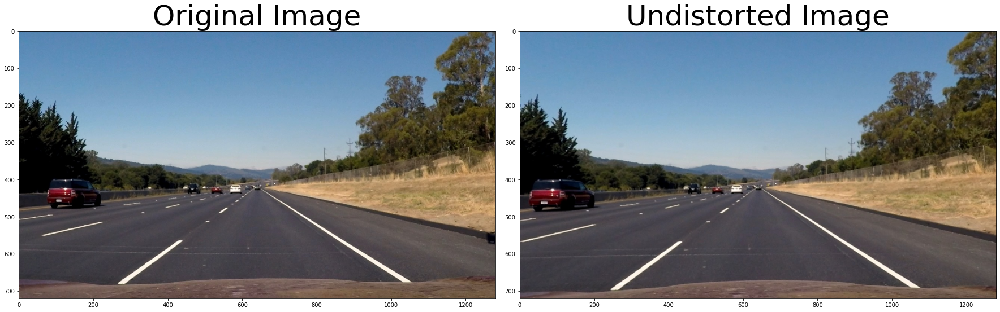

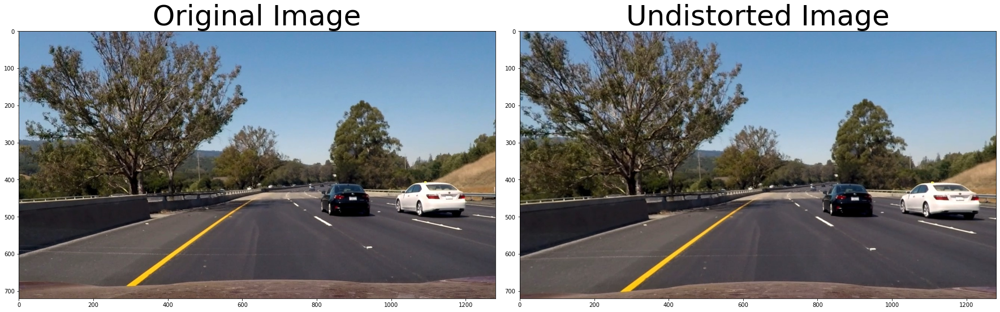

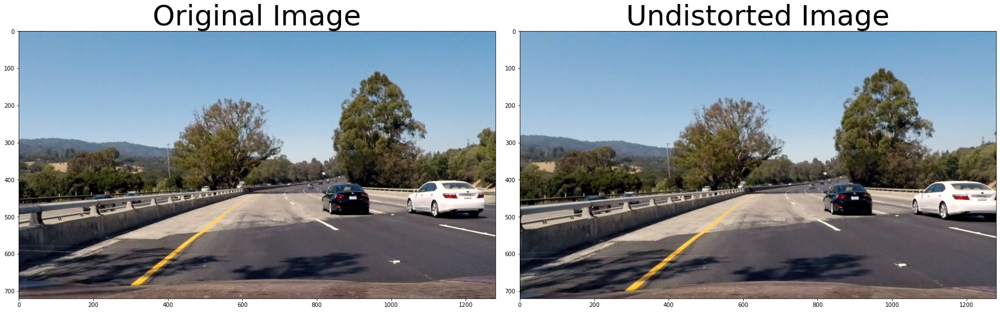

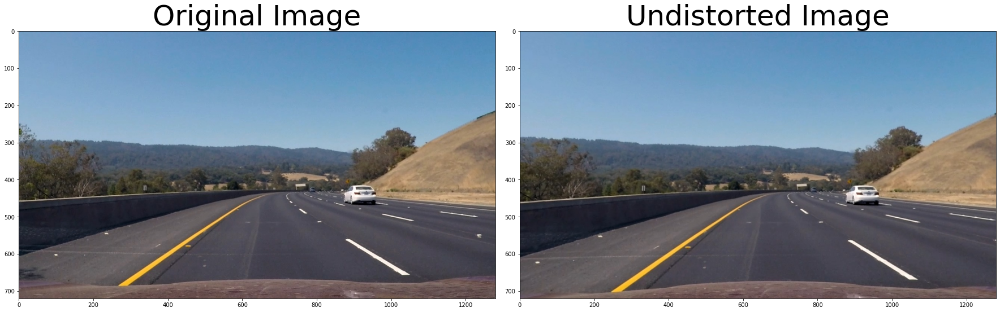

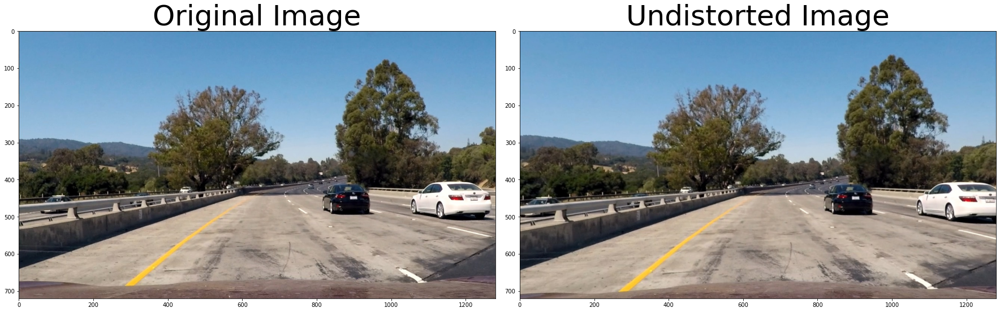

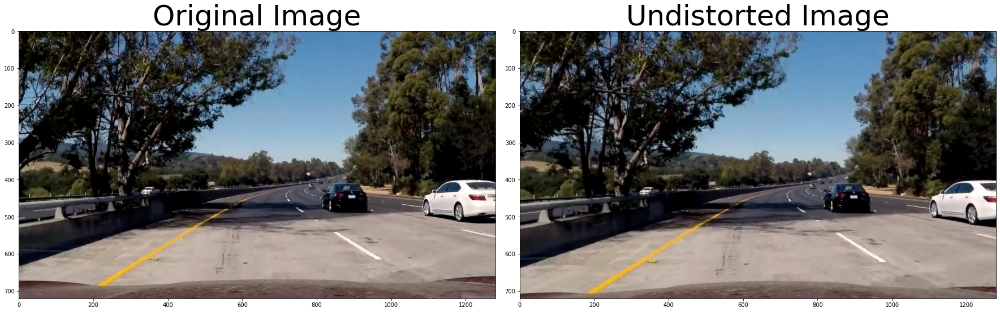

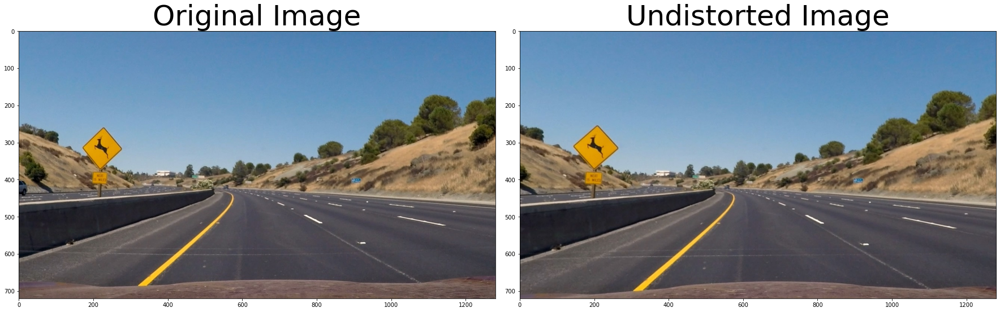

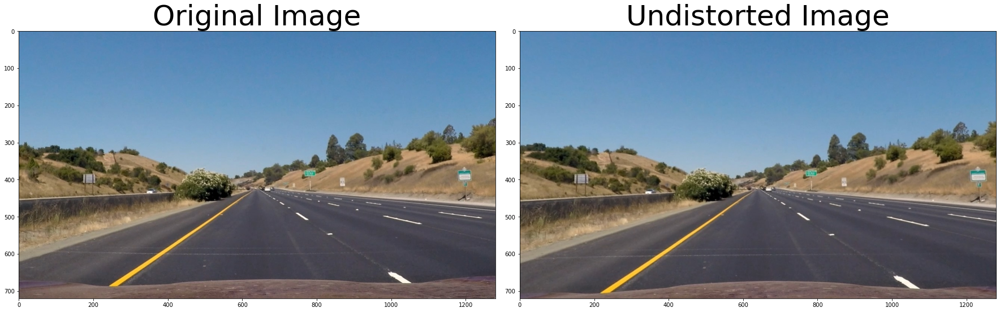

In [4]:
images = glob.glob('test_images/*.jpg')
for fname in images:
    img = cv2.imread(fname)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    # apply distortion correction
    undst = cv2.undistort(img, mtx, dist, None, mtx)
    # save processed image to output-folder
    cv2.imwrite(fname.replace('test_images/','output_images/d_'), cv2.cvtColor(undst, cv2.COLOR_RGB2BGR))
    # Define frame for side by side plot
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    # plot original image
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=50)
    # plot undistorted image
    ax2.imshow(undst)
    ax2.set_title('Undistorted Image', fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

## Produce binary threshold images

Next step in the processing pipeling is the computation of thresholded binary images. The code has been placed in a function `thresholded_binary()` to be easily reusable in further steps. The thresholded binary image is a superposition of two different images, one produced by converting the original image to HLS color space and passing the s-channel to a threshold filter cutting of values above and below certain values which are given as input parameters. The other part is the result of the application of a sobel-x filter to the grayscale of the original image also passed to a similar threshold filter but with different cut-off values.

**Note:** The encapsulation of larger processing steps into functions will be used in the following steps too to facilitate further reuse.

In [5]:
def thresholded_binary(img, s_thresh=(110, 255), sx_thresh=(20, 100)):
    # Convert to HLS color space and separate the S channel
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    s_channel = hls[:,:,2]
    l_channel = hls[:,:,1]

    # Grayscale image
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    
    # Sobel x
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0) # Take the derivative in x
    abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    
    # Threshold x gradient
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= sx_thresh[0]) & (scaled_sobel <= sx_thresh[1])] = 1
    
    # Threshold color channel
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel >= s_thresh[0]) & (s_channel <= s_thresh[1])] = 1
    
    # Combine the two binary thresholds
    combined_binary = np.zeros_like(sxbinary)
    combined_binary[(s_binary == 1) | (sxbinary == 1)] = 1
    
    return combined_binary

In the following the thresholded-binary processing is applied to the test images and the results are again plotted side-by-side. This also servers well as test of the subfuntion.

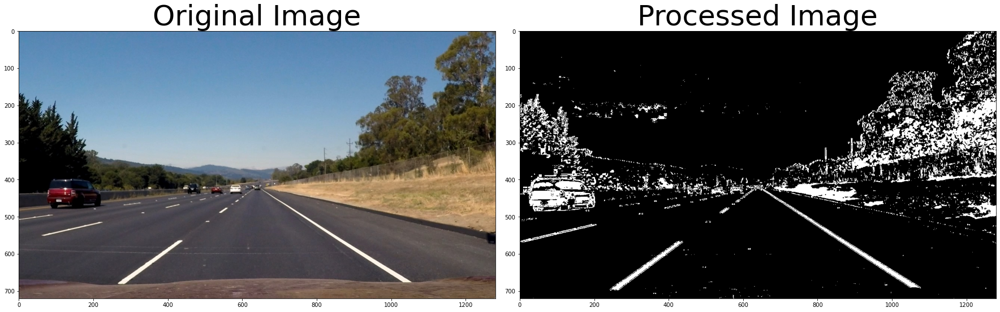

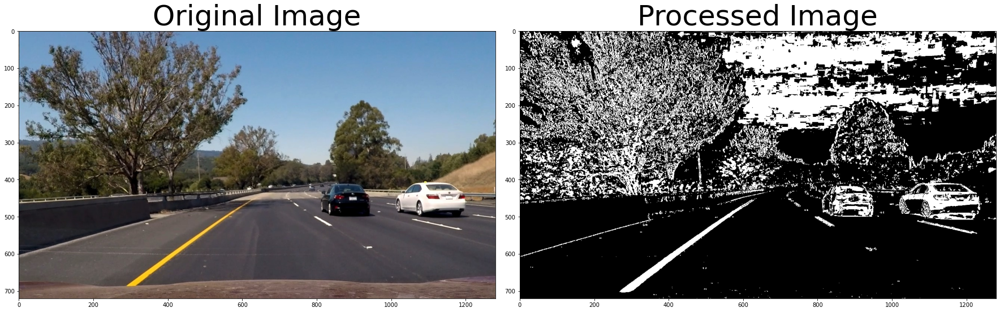

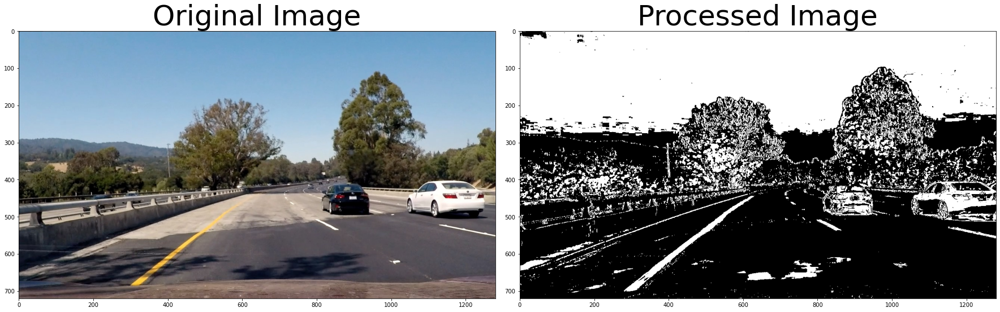

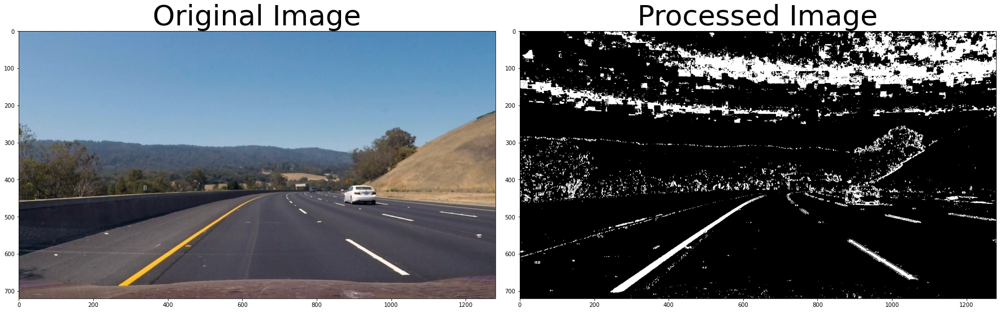

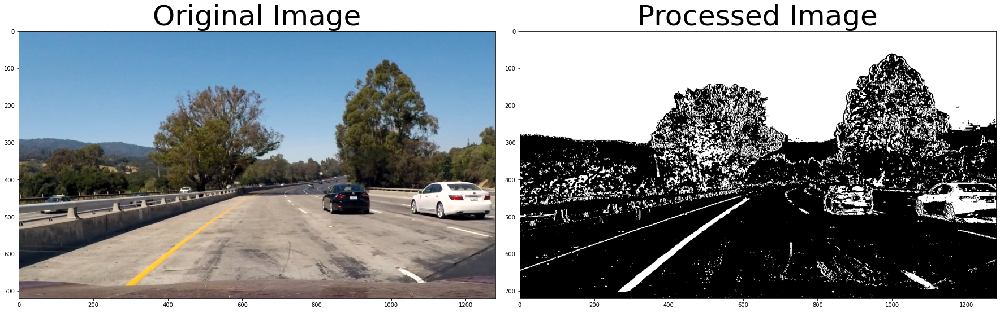

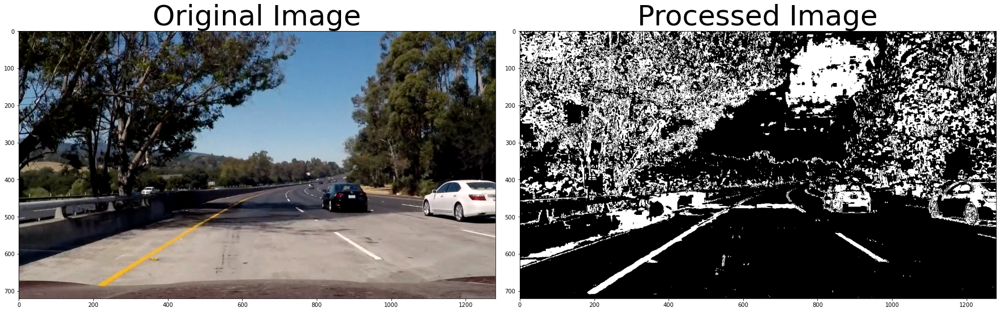

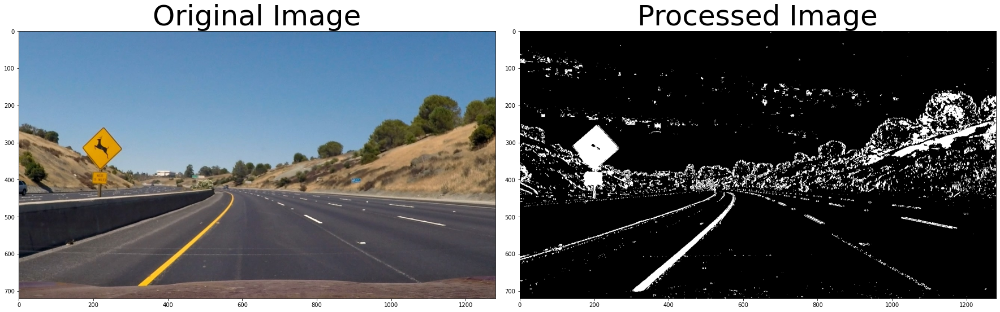

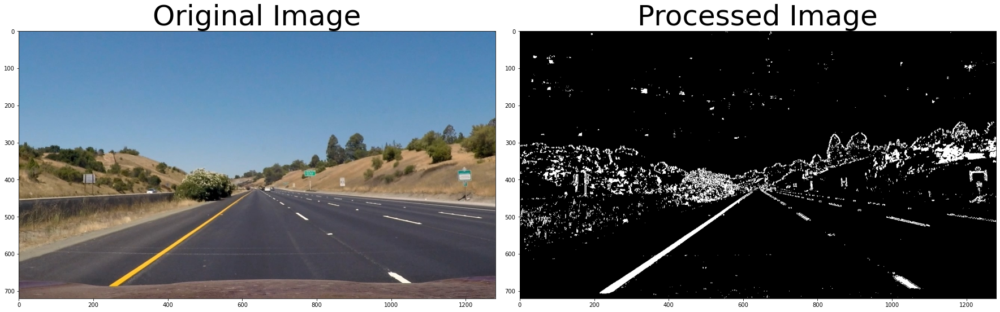

In [6]:
images = glob.glob('test_images/*.jpg')
for fname in images:
    img = cv2.imread(fname)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    # apply distortion correction
    undst = cv2.undistort(img, mtx, dist, None, mtx)
    #  computer binary thresholded image
    binary = thresholded_binary(undst)
    plt.imsave(fname.replace('test_images/','output_images/b_'), binary, cmap='gray')
    # Define frame for side by side plot
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    # plot original image
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=50)
    # plot binary thresholded image
    ax2.imshow(binary, cmap='gray')
    ax2.set_title('Processed Image', fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

## Compute warped binary thresholded images
The perspective transform of the image to a top-down-view is encapsulated in the function `warp()` below which takes an image as input. The frames of source and destination points is hard-coded in this function. The transformation matrices M and Minv are calculated (see the calls to `getPerspective()`) and returned as well as the input images with the source frame depicted with red lines. I used both straight_line*.jpg images in the test data to define the src frame as they apprently show a straight driving situation which is needed for a proper frame definition.

In [7]:
def warp(img) :
    # get image x- and y- dimensions
    img_size_y, img_size_x, _ = img.shape
    
    # define src and destination frame
    src = np.float32(
        [[(img_size_x / 2) - 60, img_size_y / 2 + 100],  # was -55  -60
         [((img_size_x / 6) - 15), img_size_y],          # was -10  -20
         [(img_size_x * 5 / 6) + 55, img_size_y],        # was +60  +60
         [(img_size_x / 2 + 65), img_size_y / 2 + 100]]) # was +55
    dst = np.float32(
        [[(img_size_x / 4), 0],
         [(img_size_x / 4), img_size_y],
         [(img_size_x * 3 / 4), img_size_y],
         [(img_size_x * 3 / 4), 0]])

    # draw src frame lines in image
    cv2.line(img, tuple(src[0]), tuple(src[1]),(255,0,0))
    cv2.line(img, tuple(src[1]), tuple(src[2]),(255,0,0))
    cv2.line(img, tuple(src[2]), tuple(src[3]),(255,0,0))
    cv2.line(img, tuple(src[3]), tuple(src[0]),(255,0,0))
    
    # computer transformation matrix M and Minv
    M = cv2.getPerspectiveTransform(src, dst)
    Minv = cv2.getPerspectiveTransform(dst, src)
    
    return img, M, Minv

To test the `warp()` function, the perspective transform is applied to all test images. Results are shown side by side with the original images. In all source and destination frames respectively are plotted in red. 

2021-01-27 00:17:47,623 [1836] WARNING  py.warnings:109: [JupyterRequire] <ipython-input-7-e00104c128c4>:18: DeprecationWarning: an integer is required (got type numpy.float32).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  cv2.line(img, tuple(src[0]), tuple(src[1]),(255,0,0))

2021-01-27 00:17:47,624 [1836] WARNING  py.warnings:109: [JupyterRequire] <ipython-input-7-e00104c128c4>:19: DeprecationWarning: an integer is required (got type numpy.float32).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  cv2.line(img, tuple(src[1]), tuple(src[2]),(255,0,0))

2021-01-27 00:17:47,625 [1836] WARNING  py.warnings:109: [JupyterRequire] <ipython-input-7-e00104c128c4>:20: DeprecationWarning: an integer is required (got type numpy.float32).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  cv2.line(img, 

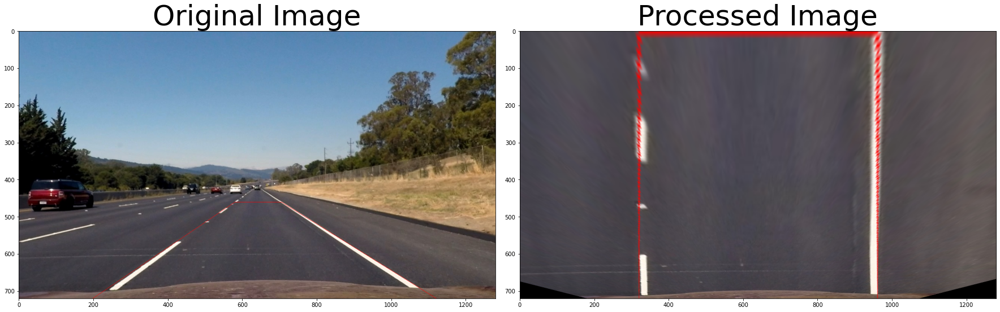

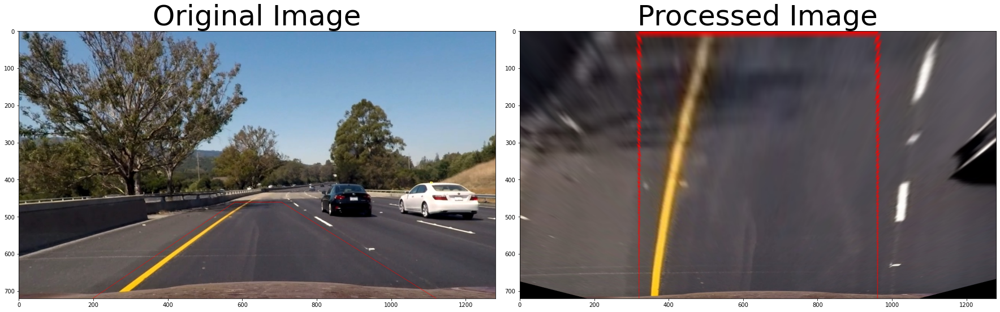

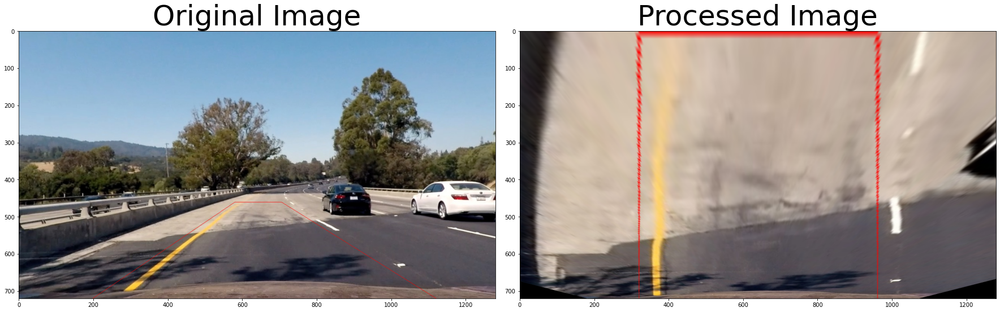

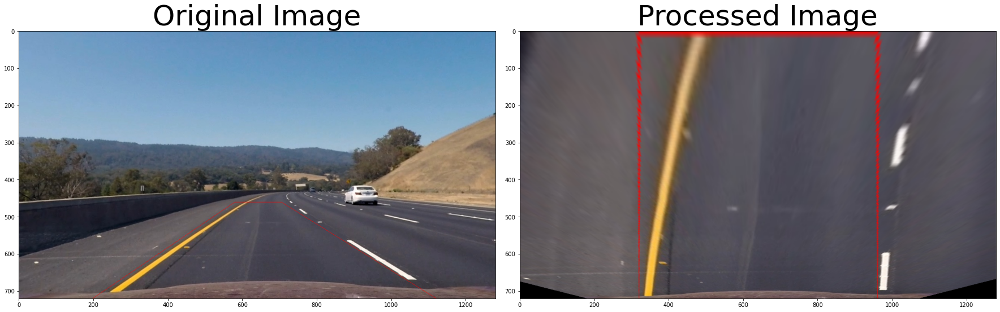

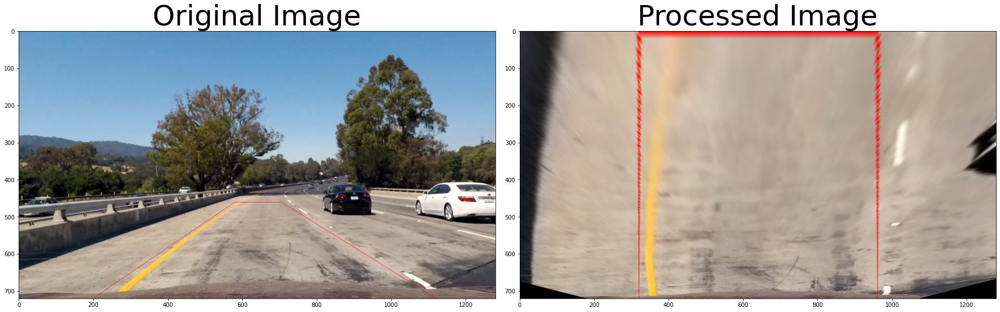

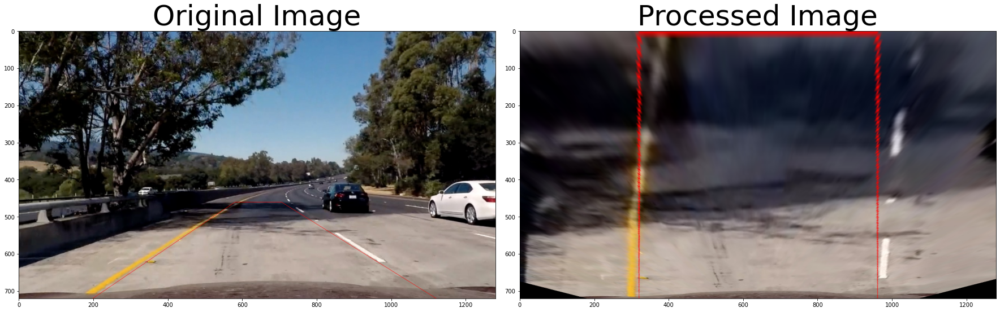

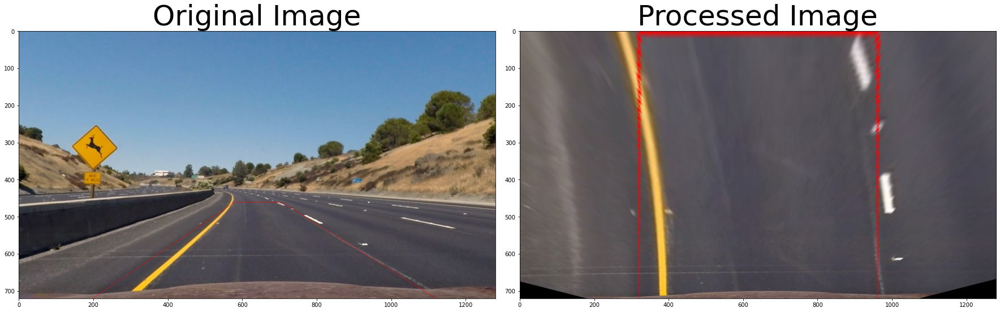

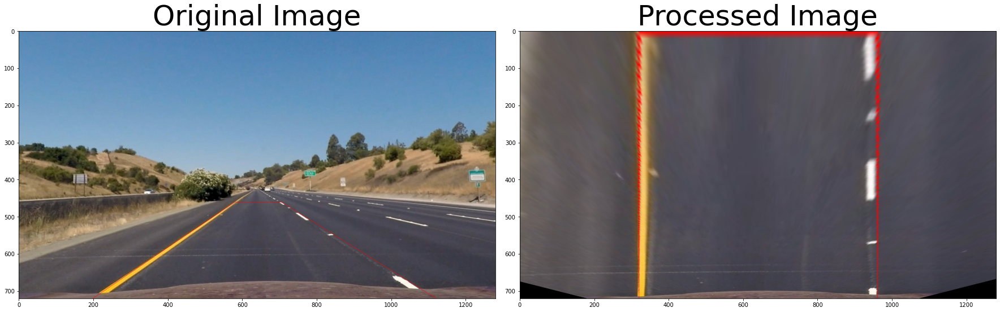

In [8]:
images = glob.glob('test_images/*.jpg')
for fname in images:
    img = cv2.imread(fname)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    
    # apply distortion correction
    undst = cv2.undistort(img, mtx, dist, None, mtx)

    # compute and store transformation matrix M and Minv in variables
    frame_img, M, Minv = warp(undst)
    
    # produce thresholded binary image
    binary = thresholded_binary(frame_img)
    
    # produce warped image with top down view
    img_size_y, img_size_x, _ = img.shape
    warped = cv2.warpPerspective(frame_img, M, (img_size_x,img_size_y), flags=cv2.INTER_LINEAR)
    # for a warped image of the tresholded binary uncomment the following line
    #warped = cv2.warpPerspective(binary, M, (img_size_x,img_size_y), flags=cv2.INTER_LINEAR)
    cv2.imwrite(fname.replace('test_images/','output_images/w_'), cv2.cvtColor(warped, cv2.COLOR_RGB2BGR))

    # Define frame for side by side plot
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    # plot original image
    ax1.imshow(frame_img)
    ax1.set_title('Original Image', fontsize=50)
    # plot warped binary thresholded image
    ax2.imshow(warped, cmap='gray')
    ax2.set_title('Processed Image', fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

## Find lane pixels and fit polynomial
In the next code cell a couple of helper functions will be defind:
#### class `Line()`
Used to keep track of important parameters from frame to frame, such as radius of curvature, last n polynomial coefficients, last polynome values, line base position, a detection counter and access functions. See also comments in the code for detailed explanation.
#### function `find_lane_pixels()`
Contains the functionality described in chapter "Locate the Lane Lines" and "Implement Sliding Windows". First the start of the lines is detected via histogram of the bottom half of the binary thresholded warped image which is given as an input parameter to the function. Then sliding windows are used to track the line to the top of the window. This means that the image is covered with a number of windows with configurable size that are stacked one on top of the other. Subsequently from the first window at the bottom each window is shifted horizontally to center around the detected lane line pixels.
#### function `search_around_polynomial()`
This functions performs the alternative algorithm to `find_lane_pixels()`. In the binary thresholded warped image which is given as an input the lines are searched in a certain margin of the polynomial of the last frame. The coefficients of the last polynomial have to be supplied as input parameters.
#### function `fit_polynomial()`
Takes the line detection points for both lines as an input and fits the polynomials to these. The polynomial lines and the real world radius of curvature are calulated and returned next to the coefficients of the polynomials. 

In [9]:
# Define a class to receive the characteristics of each line detection
class Line():
    def __init__(self):
        self.max_count = 10
        # count for number of successful high-quality detections in a row.
        # The idea is to let the counter go up to the maximum value in the beginning
        # then decrease it for every unsuccessul detection and increase it for every successful
        # if the counter reaches the lower threshold the detection methods are changes to safer setting
        self.detected = 0
        # x values of the last fit of the line
        self.current_xfitted = [] 
        #average x values of the fitted line over the last n iterations
        #self.last_ncoef = [np.array([False])]    
        #polynomial coefficients of the last n iterations
        self.last_ncoef = [np.array([False])] 
        #polynomial coefficients for the most recent fit
        self.current_coef = [np.array([False])]  
        #radius of curvature of the line in some units
        self.curverad = 0 
        #distance in meters of vehicle center from the line
        self.line_base_pos = 0 
        #difference in fit coefficients between last and new fits
        #self.diffs = np.array([0,0,0], dtype='float') 
        #x values for detected line pixels
        #self.allx = None  
        #y values for detected line pixels
        #self.ally = None
        
    # Increase detection counter up to a maximum value
    def incDetection(self):
        self.detected = min((self.detected+1),self.max_count)
        
    # Decrease detection count down to max 0
    def decDetection(self):
        self.detected = max(0, (self.detected-1))
    
    # Store latest polynomial coefficients.
    # If the store reaches the maximum the oldest coefficients are deleted
    def storeCoefficients(self, coeff):
        self.last_ncoef.append(coeff)
        self.current_coef = coeff
        if len(self.last_ncoef) > self.max_count :
            del(self.last_ncoef[0])
        else :
            # flush the pipeline to get rid of the initialization value 'False'
            self.storeCoefficients(coeff)
    
    # Returns the mean value of the stored coefficients
    def getMeanCoefficients(self):
        return np.mean(self.last_ncoef, axis=0)
    
def find_lane_pixels(binary_warped):
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
    # Create an output image to draw on and visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]//2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # HYPERPARAMETERS
    # Choose the number of sliding windows
    nwindows = 9
    # Set the width of the windows +/- margin
    margin = 110
    # Set minimum number of pixels found to recenter window
    minpix = 50

    # Set height of windows - based on nwindows above and image shape
    window_height = np.int(binary_warped.shape[0]//nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated later for each window in nwindows
    leftx_current = leftx_base
    rightx_current = rightx_base

    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        ### Find the four below boundaries of the window
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),
        (win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),
        (win_xright_high,win_y_high),(0,255,0), 2) 
        
        ### Identify the nonzero pixels in x and y within the window
        good_left_inds =  ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) &
                           (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) &
                           (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
        
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        
        ### If found > minpix pixels, recenter next window
        ### (`right` or `leftx_current`) on their mean position
        if len(good_left_inds) > minpix :
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix :
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))
        

    # Concatenate the arrays of indices (previously was a list of lists of pixels)
    try:
        left_lane_inds = np.concatenate(left_lane_inds)
        right_lane_inds = np.concatenate(right_lane_inds)
    except ValueError:
        # Avoids an error if the above is not implemented fully
        pass

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    ## Visualization ##
    # Colors in the left and right lane regions
    out_img[lefty, leftx] = [255, 0, 0]
    out_img[righty, rightx] = [0, 0, 255]
    
    return leftx, lefty, rightx, righty, out_img

def search_around_poly(binary_warped, left_fit, right_fit):
    # HYPERPARAMETER
    # Choose the width of the margin around the previous polynomial to search
    # The quiz grader expects 100 here, but feel free to tune on your own!
    margin = 110

    # Grab activated pixels
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    # Set the area of search based on activated x-values
    # within the +/- margin of our polynomial function
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + 
                    left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + 
                    left_fit[1]*nonzeroy + left_fit[2] + margin)))
    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + 
                    right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + 
                    right_fit[1]*nonzeroy + right_fit[2] + margin)))
    
    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    
    return leftx, lefty, rightx, righty


def fit_polynomial(leftx, lefty, rightx, righty, ploty):

    # Fit a second order polynomial to each using `np.polyfit`
    left_fit  = np.polyfit(lefty , leftx , 2)
    right_fit = np.polyfit(righty, rightx, 2)

    # Generate x and y values for plotting
    try:
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    except TypeError:
        # Avoids an error if `left` and `right_fit` are still none or incorrect
        print('The function failed to fit a line!')
        left_fitx = 1*ploty**2 + 1*ploty
        right_fitx = 1*ploty**2 + 1*ploty

    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    
    # computer curvature
    left_fit_cr = np.polyfit(lefty*ym_per_pix, leftx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(righty*ym_per_pix, rightx*xm_per_pix, 2)

    # Define y-value where we want radius of curvature
    # We'll choose the maximum y-value, corresponding to the bottom of the image = position of the car
    y_eval = np.max(ploty*ym_per_pix)
    
    # Calculate radius of curvature
    left_curverad = ((1+(2*left_fit_cr[0]*y_eval*ym_per_pix+left_fit_cr[1])**2)**1.5)/np.absolute(2*left_fit_cr[0])
    right_curverad =((1+(2*right_fit_cr[0]*y_eval*ym_per_pix+right_fit_cr[1])**2)**1.5)/np.absolute(2*right_fit_cr[0])
    
    return left_fit, right_fit, left_fitx, right_fitx, left_curverad, right_curverad


The processing pipeline is now complete and will be applied to the test images:
1. undistortion
2. binary thresholing
3.  warping
4. lane finding in warped binary thresholded image
5. fitting of polynomes to the detected lines

Visualization of detections in original and processed (warped binary thresholded) image:
1. Drawing of polynomes and warping back to original image
2. Showing polynomes, detected line pixels and sliding detection windows in binary warped image
The original image with detected polynomes plus area in between (1.) and the binary warped image (2.) are shown side by side.

2021-01-27 00:18:22,605 [1836] WARNING  py.warnings:109: [JupyterRequire] <ipython-input-7-e00104c128c4>:18: DeprecationWarning: an integer is required (got type numpy.float32).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  cv2.line(img, tuple(src[0]), tuple(src[1]),(255,0,0))

2021-01-27 00:18:22,605 [1836] WARNING  py.warnings:109: [JupyterRequire] <ipython-input-7-e00104c128c4>:19: DeprecationWarning: an integer is required (got type numpy.float32).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  cv2.line(img, tuple(src[1]), tuple(src[2]),(255,0,0))

2021-01-27 00:18:22,606 [1836] WARNING  py.warnings:109: [JupyterRequire] <ipython-input-7-e00104c128c4>:20: DeprecationWarning: an integer is required (got type numpy.float32).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  cv2.line(img, 

2021-01-27 00:18:23,713 [1836] WARNING  py.warnings:109: [JupyterRequire] <ipython-input-7-e00104c128c4>:18: DeprecationWarning: an integer is required (got type numpy.float32).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  cv2.line(img, tuple(src[0]), tuple(src[1]),(255,0,0))

2021-01-27 00:18:23,714 [1836] WARNING  py.warnings:109: [JupyterRequire] <ipython-input-7-e00104c128c4>:19: DeprecationWarning: an integer is required (got type numpy.float32).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  cv2.line(img, tuple(src[1]), tuple(src[2]),(255,0,0))

2021-01-27 00:18:23,715 [1836] WARNING  py.warnings:109: [JupyterRequire] <ipython-input-7-e00104c128c4>:20: DeprecationWarning: an integer is required (got type numpy.float32).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  cv2.line(img, 

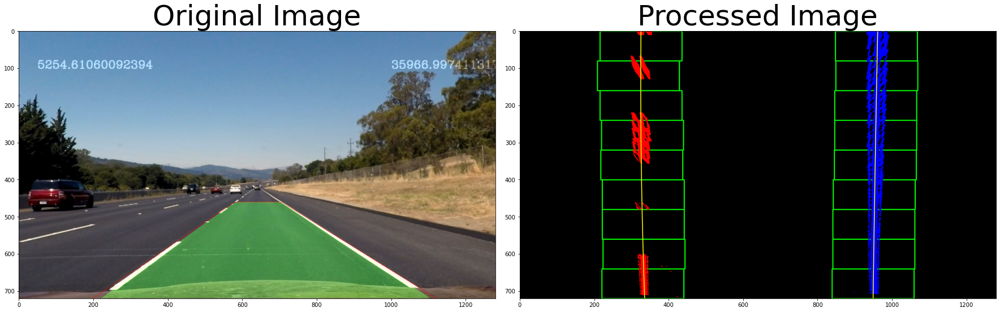

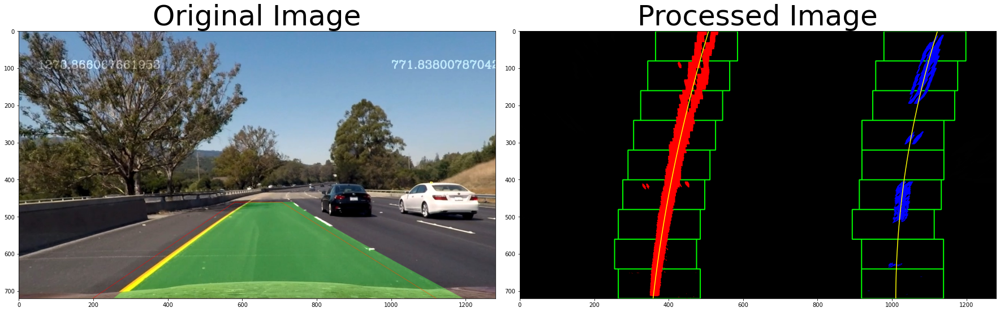

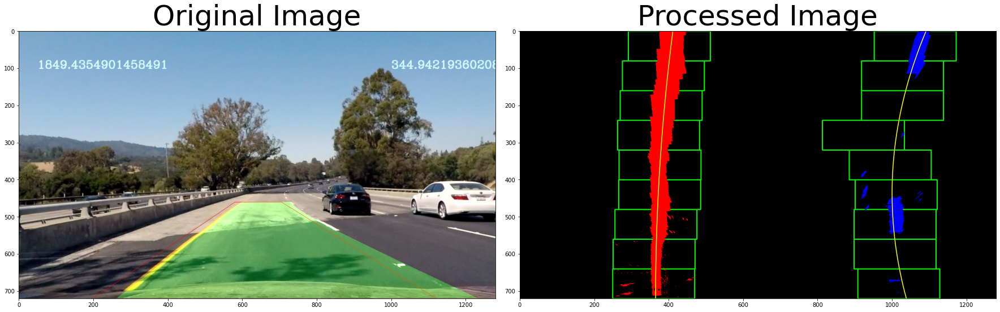

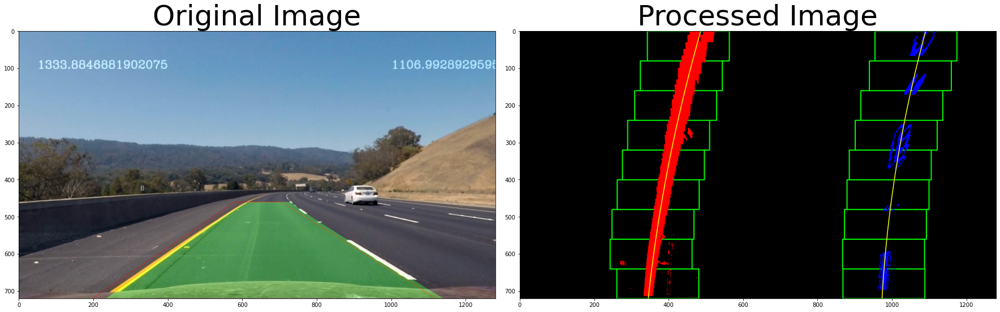

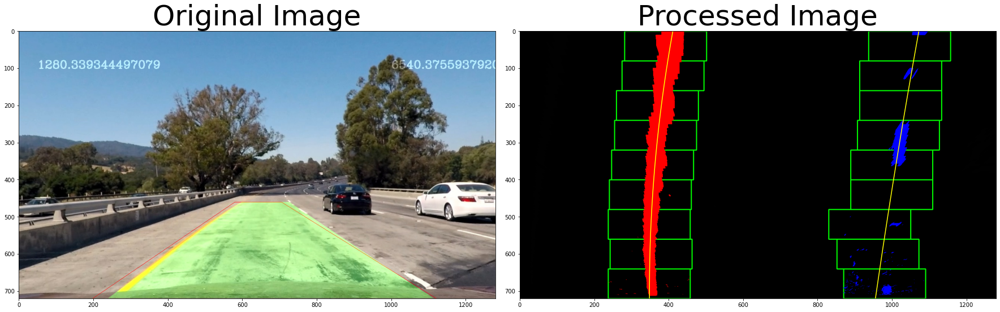

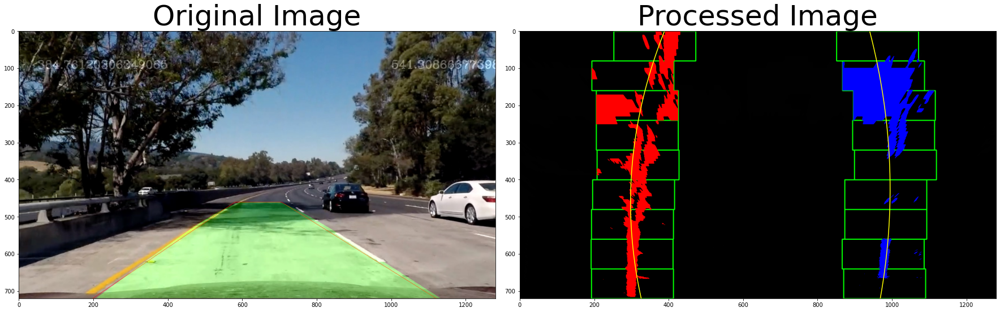

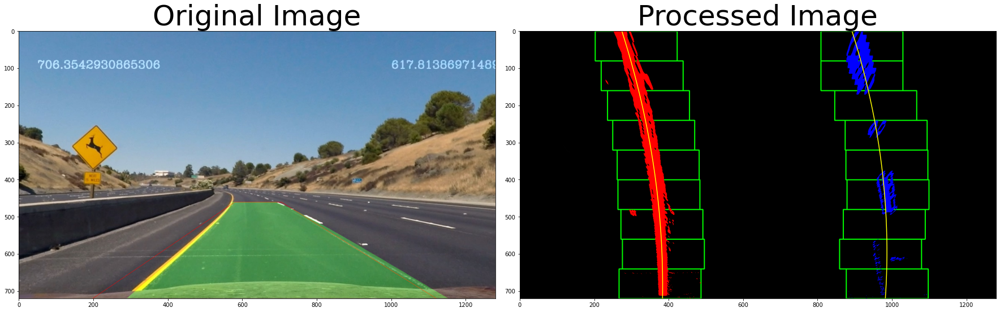

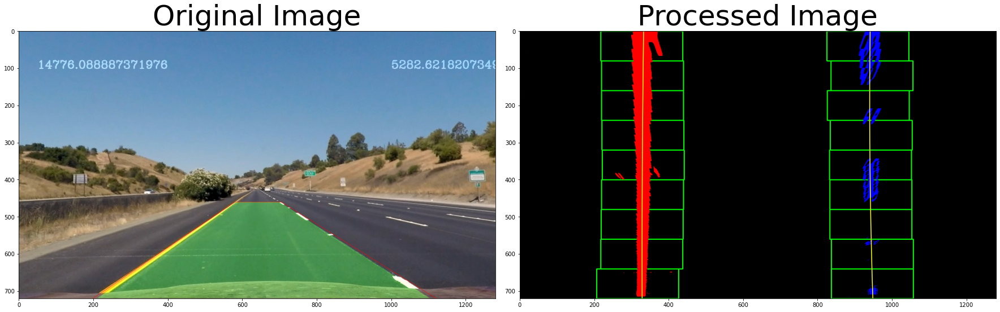

In [10]:
images = glob.glob('test_images/*.jpg')
for fname in images:
    img = cv2.imread(fname)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    
    # Undistort image
    undst = cv2.undistort(img, mtx, dist, None, mtx)
    # computer binary threshold
    binary = thresholded_binary(undst)
    
    # define frames for warping and warp image
    frame_img, M, Minv = warp(undst)
    img_size_y, img_size_x, _ = img.shape
    binary_warped = cv2.warpPerspective(binary, M, (img_size_x,img_size_y), flags=cv2.INTER_LINEAR)
    
    # find lanes and fit polynomial
    leftx, lefty, rightx, righty, out_img = find_lane_pixels(binary_warped)
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    _,_, left_fitx, right_fitx, left_curverad, right_curverad = fit_polynomial(leftx, lefty, rightx, righty, ploty)

    #plt.imshow(out_img)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    # Plots the left and right polynomials on the lane lines
    plt.plot(left_fitx, ploty, color='yellow')
    plt.plot(right_fitx, ploty, color='yellow')
    ax2.imshow(out_img, cmap='gray')
    ax2.set_title('Processed Image', fontsize=50)
    
    cv2.imwrite(fname.replace('test_images/','output_images/p_'), cv2.cvtColor(out_img,cv2.COLOR_RGB2BGR))
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(binary_warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))
    
    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))
    
    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))
    
    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (img.shape[1], img.shape[0]))
    cv2.putText(newwarp, str(left_curverad), (50,100), cv2.FONT_HERSHEY_COMPLEX,1.0,(255,255,255),2)
    cv2.putText(newwarp, str(right_curverad), (1000,100), cv2.FONT_HERSHEY_COMPLEX,1.0,(255,255,255),2)
    # Combine the result with the original image
    result = cv2.addWeighted(undst, 1, newwarp, 0.3, 0)

    cv2.imwrite(fname.replace('test_images/','output_images/o_'), cv2.cvtColor(result,cv2.COLOR_RGB2BGR))

    ax1.imshow(result)
    ax1.set_title('Original Image', fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)    

## Define a processing pipeline without intermediate plotting that can be used for videos
The processing pipeline from the code cell above is now encapsulated in a function so that it can be used for video processing. Besides this sanity checks are implemented after all detections steps are done. Three type of checks are used:
- check for reasonable lane width on three positions in the warped image
- check for delta in base position to previous frame
- (check for delta in curvature to previous frame)

The last check was not used in the end due to highly fluctuating curve radius and problems with straight lines. 

In [11]:
 def process_image(img, mtx=mtx, dist=dist, M=M, Minv=Minv):
    # Undistort image
    undst = cv2.undistort(img, mtx, dist, None, mtx)
    # computer binary threshold
    binary = thresholded_binary(undst)
    
    # Define a variable for adding additional debugging output to each image
    info = ''
    debug = False  # Set this value to True to see more detailed output in the image/video 
    
    # define frames for warping and warp image
    img_size_y, img_size_x, _ = img.shape
    binary_warped = cv2.warpPerspective(binary, M, (img_size_x,img_size_y), flags=cv2.INTER_LINEAR)

    # find lanes and fit polynomial
    if (min(LeftLine.detected, RightLine.detected) < 5):
        leftx, lefty, rightx, righty, _ = find_lane_pixels(binary_warped)
        info = info + 'Find '
    else :
        leftx, lefty, rightx, righty = search_around_poly(binary_warped, LeftLine.current_coef, RightLine.current_coef)
    
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fit, right_fit, left_fitx, right_fitx, left_curverad, right_curverad = fit_polynomial(leftx, lefty, rightx, righty, ploty)
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    delta = round((img_size_x - left_fitx[-1] - right_fitx[-1])*xm_per_pix*100)/100
    
    # perform sanity check
    lane_width_base = (right_fitx[-1]-left_fitx[-1])*xm_per_pix
    lane_width_mid = (right_fitx[img_size_y//2]-left_fitx[img_size_y//2])*xm_per_pix
    lane_width_top = (right_fitx[0]-left_fitx[0])*xm_per_pix
    
    width_ok = ((lane_width_base > 2.5) and (lane_width_base < 4.5) and
                (lane_width_mid > 2.5) and (lane_width_mid < 4.5) and
                (lane_width_top > 2.5) and (lane_width_top < 4.5))
    
    # Sanity check for left line detections
    left_deltaRad_ok = abs(LeftLine.curverad - left_curverad) < 100
    left_delta_base_ok = abs(LeftLine.line_base_pos - leftx[-1]) < 20
    
    if (width_ok and  left_delta_base_ok) or (LeftLine.detected < 5) :
        # lane detections seem reasonable
        # Update store of values
        LeftLine.incDetection()
        LeftLine.curverad = left_curverad
        LeftLine.line_base_pos = leftx[-1]
        LeftLine.current_xfitted = left_fitx
        LeftLine.storeCoefficients(left_fit)
    else :
        # Lane detections discarded, last stored values will be used
        info = info + ' DropL' + str(LeftLine.detected)
        LeftLine.decDetection()
        left_curverad = LeftLine.curverad 
        left_fitx = LeftLine.current_xfitted
        
    # Compute ploynomial lines from stored fits
    left_fit = LeftLine.getMeanCoefficients()
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        
    # Sanity check for right line detections
    right_deltaRad_ok = abs(RightLine.curverad - right_curverad)
    right_delta_base_ok = abs(RightLine.line_base_pos - rightx[-1]) < 20
        
    if (width_ok and right_delta_base_ok) or (RightLine.detected < 5) :
        # lane detections seem reasonable
        # Update store of values
        RightLine.incDetection()
        RightLine.curverad = right_curverad
        RightLine.line_base_pos = rightx[-1]
        RightLine.current_xfitted = right_fitx
        RightLine.storeCoefficients(right_fit)
    else :
        # Lane detections discarded, last stored values will be used
        info = info + ' DropR' + str(RightLine.detected)
        RightLine.decDetection()
        right_curverad = RightLine.curverad
        right_fitx = RightLine.current_xfitted
    
    # Compute ploynomial lines from stored fits
    right_fit = RightLine.getMeanCoefficients()
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
        
    # Define text for images
    if (debug == True) :
        # More detailed debug output
        line1 = 'curvature radius in m = ' + str(int(left_curverad)) + ' , ' + str(int(right_curverad))
        line2 = 'vehicle is ' + str(delta) + 'm right of center ' + info 
    else :
        line1 = 'curvature radius in m = ' + str(int((left_curverad+right_curverad)//2))
        line2 = 'vehicle is ' + str(delta) + 'm right of center '
    
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(binary_warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))
    
    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))
    
    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))
    
    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (img.shape[1], img.shape[0])) 
    cv2.putText(newwarp, line1, (100,50), cv2.FONT_HERSHEY_COMPLEX,1.0,(255,255,255),2)
    cv2.putText(newwarp, line2, (100,100), cv2.FONT_HERSHEY_COMPLEX,1.0,(255,255,255),2)

    # Combine the result with the original image and return it
    return cv2.addWeighted(undst, 1, newwarp, 0.3, 0)
    

## Test of the processing pipeline on an image
The function is now applied to one of the test images.

2021-01-27 00:19:16,297 [1836] WARNING  py.warnings:109: [JupyterRequire] <ipython-input-7-e00104c128c4>:18: DeprecationWarning: an integer is required (got type numpy.float32).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  cv2.line(img, tuple(src[0]), tuple(src[1]),(255,0,0))

2021-01-27 00:19:16,299 [1836] WARNING  py.warnings:109: [JupyterRequire] <ipython-input-7-e00104c128c4>:19: DeprecationWarning: an integer is required (got type numpy.float32).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  cv2.line(img, tuple(src[1]), tuple(src[2]),(255,0,0))

2021-01-27 00:19:16,301 [1836] WARNING  py.warnings:109: [JupyterRequire] <ipython-input-7-e00104c128c4>:20: DeprecationWarning: an integer is required (got type numpy.float32).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  cv2.line(img, 

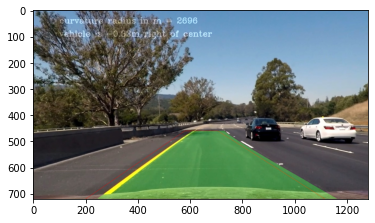

In [12]:
import matplotlib.image as mpimg
# In case the camera has not been calibrated, uncomment the following line
#mtx, dist = calibrateCamera()

img = cv2.imread('test_images/test6.jpg')
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
frame_img, M, Minv = warp(img)

LeftLine = Line()
RightLine = Line()

result = process_image(img) # , mtx, dist, M, Minv)
#mpimg.imsave('1.jpg', result)
plt.imshow(result)

## Processing of the project_video
Processing is now tested on the three supplied videos.

In [13]:
# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML

LeftLine = Line()
RightLine = Line()

white_output = 'output_videos/project_video.mp4'
clip1 = VideoFileClip("project_video.mp4")
white_clip = clip1.fl_image(process_image) #NOTE: this function expects color images!!
%time white_clip.write_videofile(white_output, audio=False)

t:   0%|          | 3/1260 [00:00<00:59, 21.16it/s, now=None]

Moviepy - Building video output_videos/project_video.mp4.
Moviepy - Writing video output_videos/project_video.mp4



Moviepy - Done !
Moviepy - video ready output_videos/project_video.mp4
CPU times: user 2min 23s, sys: 26.2 s, total: 2min 49s
Wall time: 1min 11s


## Processing of the first challenge_video

In [14]:
LeftLine = Line()
RightLine = Line()

white_output = 'output_videos/challenge_video.mp4'
clip1 = VideoFileClip("challenge_video.mp4")
white_clip = clip1.fl_image(process_image) #NOTE: this function expects color images!!
%time white_clip.write_videofile(white_output, audio=False)

t:   1%|          | 3/485 [00:00<00:22, 20.98it/s, now=None]

Moviepy - Building video output_videos/challenge_video.mp4.
Moviepy - Writing video output_videos/challenge_video.mp4



t: 100%|██████████| 485/485 [00:24<00:00, 20.83it/s, now=None]2021-01-27 00:20:57,727 [1836] WARNING  py.warnings:109: [JupyterRequire] /home/tschoepe/.local/lib/python3.8/site-packages/moviepy/video/io/ffmpeg_reader.py:123: UserWarning: Warning: in file challenge_video.mp4, 2764800 bytes wanted but 0 bytes read,at frame 484/485, at time 16.15/16.15 sec. Using the last valid frame instead.
  warnings.warn("Warning: in file %s, "%(self.filename)+



Moviepy - Done !
Moviepy - video ready output_videos/challenge_video.mp4
CPU times: user 51.5 s, sys: 10.2 s, total: 1min 1s
Wall time: 25 s


## Processing of the first harder_challenge_video

In [15]:
LeftLine = Line()
RightLine = Line()

white_output = 'output_videos/harder_challenge_video.mp4'
clip1 = VideoFileClip("harder_challenge_video.mp4")
white_clip = clip1.fl_image(process_image) #NOTE: this function expects color images!!
%time white_clip.write_videofile(white_output, audio=False)

t:   0%|          | 3/1199 [00:00<01:11, 16.80it/s, now=None]

Moviepy - Building video output_videos/harder_challenge_video.mp4.
Moviepy - Writing video output_videos/harder_challenge_video.mp4



Moviepy - Done !
Moviepy - video ready output_videos/harder_challenge_video.mp4
CPU times: user 2min 37s, sys: 28.6 s, total: 3min 6s
Wall time: 1min 31s


In [ ]:
HTML("""
<video width="1280" height="700" controls>
  <source src="{0}">
</video>
""".format(white_output))